In [1]:
## This version excludes CONTINUOUS Variables and the RFD variables AND _wHICH VARIABLES 3/27/2024 and con_max_consultorder_time/day and drg name
## 4/4/2024 Added QUINTILE variables
## 4/8/2024 Added QUINTILE varables by service
## 4/9/2024 Added more consult and imaging variables (e.g. ad,it order to consult order, admit order to imaging read)
## 4/11/2024 Added QUINTILE variables by service for the additional variables
## 4/13/2024 Added con_unique_services_which and con_unique_services_which2 variables

In [2]:
import pandas as pd
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from feature_engine.selection import DropConstantFeatures, DropDuplicateFeatures, SmartCorrelatedSelection
from feature_engine.encoding import OneHotEncoder
from feature_engine.selection import DropFeatures, DropConstantFeatures, DropDuplicateFeatures, SmartCorrelatedSelection
from feature_engine.imputation import AddMissingIndicator
from feature_engine.outliers import Winsorizer
from sklearn.preprocessing import MinMaxScaler
from feature_engine.discretisation import DecisionTreeDiscretiser
from sklearn.model_selection import GroupShuffleSplit

from feature_engine.wrappers import SklearnTransformerWrapper
from feature_engine.imputation import ArbitraryNumberImputer
from feature_engine.imputation import MeanMedianImputer
from feature_engine.imputation import CategoricalImputer
from feature_engine.encoding import RareLabelEncoder
from sklearn.impute import SimpleImputer

#pip install xgboost==0.90
import xgboost as xgb
import plotly.express as px
import shap

#https://github.com/liannewriting/YouTube-videos-public/blob/main/xgboost-python-tutorial-example/xgboost_python.ipynb
from category_encoders.target_encoder import TargetEncoder
from xgboost import XGBClassifier
#hyperparameter values
from skopt import BayesSearchCV
from skopt.space import Real, Categorical, Integer

from sklearn.metrics import accuracy_score, precision_score, recall_score, confusion_matrix, f1_score, roc_auc_score, classification_report, precision_recall_curve
from sklearn.calibration import calibration_curve

import warnings
warnings.filterwarnings('ignore')

In [3]:
df_all = pd.read_csv('/gpfs/milgram/project/rtaylor/imc33/data/clean/master_los.csv', index_col=[0])

In [4]:
pd.set_option('display.max_columns', None)

In [5]:
df_all.head()

,admissiondate,dischargedate,pat_mrn_id,viz_primary_payer_name,viz_disp_collapsed,viz_age,viz_ethnicity,viz_race,viz_race_collapsed,viz_language,viz_insurance,viz_service_collapsed,viz_ynhhs_sg2_service,viz_observed_mortality_yn,viz_drg,viz_admission_day,viz_discharged_day,viz_outcome_prolonged_los_yn,thro_door_to_admit_order_hrs,thro_admit_order_to_first_bed_hrs,thro_last_bed_to_ed_dept_hrs,thro_admit_order_to_ed_dept_hrs,thro_boarding_yn,thro_ed_arrival_time,thro_ed_arrival_day,thro_admit_or_obs_order_time,thro_admit_or_obs_order_day,thro_first_bed_assigned_time,thro_first_bed_assigned_day,thro_last_bed_assigned_time,thro_last_bed_assigned_day,thro_ed_departure_time,thro_ed_departure_day,summary_consult_count_all,summary_consult_count_unique_services,summary_pt_consult_order_yn,summary_pt_consult_order_time,summary_pt_consult_order_day,summary_sw_consult_order_yn,summary_sw_consult_order_time,summary_sw_consult_order_day,summary_first_edd_time,summary_first_edd_day,summary_first_edd_doc_time,summary_first_edd_doc_day,summary_first_edd_to_discharge_hrs,summary_first_edd_doc_to_discharge_hrs,summary_last_edd_time,summary_last_edd_day,summary_last_edd_doc_time,summary_last_edd_doc_day,summary_last_edd_to_discharge_hrs,summary_last_edd_doc_to_discharge_hrs,summary_first_rfd_status,summary_first_rfd_time,summary_first_rfd_day,summary_first_rfd_to_discharge_hrs,summary_last_rfd_status,summary_last_rfd_time,summary_last_rfd_day,summary_last_rfd_to_discharge_hrs,summary_total_hrs_nmr,summary_total_hrs_mrwb,summary_total_hrs_mrnb,rfd_first_nmr_start_day,rfd_first_nmr_start_time,rfd_first_mrnb_start_day,rfd_first_mrnb_start_time,rfd_first_mrwb_start_day,rfd_first_mrwb_start_time,rfd_first_nmr_to_discharge_hrs,rfd_first_mrnb_to_discharge_hrs,rfd_first_mrwb_to_discharge_hrs,rfd_last_nmr_effective_end_day,rfd_last_nmr_effective_end_time,rfd_last_mrnb_effective_end_day,rfd_last_mrnb_effective_end_time,rfd_last_mrwb_effective_end_day,rfd_last_mrwb_effective_end_time,rfd_last_nmr_to_discharge_hrs,rfd_last_mrnb_to_discharge_hrs,rfd_last_mrwb_to_discharge_hrs,con_max_consult_order_to_sign_any_hrs,con_avg_consult_order_to_sign_any_hrs,con_signer_ym_provider_count,con_signer_nemg_provider_count,con_signer_community_provider_count,con_max_consult_order_to_sign_any_quintile,con_avg_consult_order_to_sign_any_quintile,con_max_consult_note_to_sign_any_hrs,con_avg_consult_note_to_sign_any_hrs,con_max_consult_note_to_sign_any_quintile,con_avg_consult_note_to_sign_any_quintile,con_max_consult_order_to_sign_colon_and_rectal_hrs,con_max_consult_order_to_sign_diabetes_hrs,con_max_consult_order_to_sign_hematology_hrs,con_max_consult_order_to_sign_infectious_disease_hrs,con_max_consult_order_to_sign_lab_medicine_hrs,con_max_consult_order_to_sign_nephrology_hrs,con_max_consult_order_to_sign_oncology_hrs,con_max_consult_order_to_sign_picc_hrs,con_max_consult_order_to_sign_palliative_hrs,con_max_consult_order_to_sign_pulmonology_hrs,con_max_consult_order_to_sign_radiation_oncology_hrs,con_max_consult_order_to_sign_radiology_hrs,con_max_consult_order_to_sign_urology_hrs,con_max_consult_order_to_sign_cardiology_hrs,con_max_consult_order_to_sign_gastroenterology_hrs,con_max_consult_order_to_sign_hepatology_hrs,con_max_consult_order_to_sign_other_hrs,con_max_consult_order_to_sign_pharmacy_hrs,con_max_consult_order_to_sign_plastic_surgery_hrs,con_max_consult_order_to_sign_surgery_hrs,con_max_consult_order_to_sign_vascular_surgery_hrs,con_max_consult_order_to_sign_neurology_hrs,con_max_consult_order_to_sign_hospitalist_service_hrs,con_max_consult_order_to_sign_psychiatry_hrs,con_max_consult_order_to_sign_internal_medicine_hrs,con_max_consult_order_to_sign_neuro_oncology_hrs,con_max_consult_order_to_sign_neurosurgery_hrs,con_max_consult_order_to_sign_ophthalmology_hrs,con_max_consult_order_to_sign_orthopedics_hrs,con_max_consult_order_to_sign_physical_medicine_and_rehabilitation_hrs,con_max_consult_order_to_sign_podiatry_hrs,con_max_consult_order_to_sign_dermatology_

In [6]:
df_all.shape

(13043, 922)

In [7]:
df_all["viz_disp_collapsed"].value_counts()

viz_disp_collapsed
Other    8229
Home     4814
Name: count, dtype: int64

In [8]:
df_all["thro_boarding_yn"].value_counts()

thro_boarding_yn
1.0    6825
0.0    5498
Name: count, dtype: int64

In [9]:
df_all["viz_drg"].value_counts()

viz_drg
Septicemia or severe sepsis w/o mv >96 hours w mcc                                           2060
heart failure & shock w mcc                                                                  1372
Respiratory infections & inflammations w mcc                                                 1056
Esophagitis, gastroent & misc digest disorders w/o mcc                                        678
Simple pneumonia & pleurisy w mcc                                                             627
Cellulitis w/o mcc                                                                            454
Septicemia or severe sepsis w/o mv >96 hours w/o mcc                                          437
Renal failure w mcc                                                                           426
Pulmonary edema & respiratory failure                                                         425
Infectious & parasitic diseases w o.r. procedure w mcc                                        352
Intracranial

In [10]:
#Filter for home patients
#df_filt = df_all.copy()
df_filt = df_all[(df_all["viz_drg"]=="heart failure & shock w mcc") & (df_all["viz_disp_collapsed"] == "Home")].copy()
#df_filt = df_all[df_all["viz_disp_collapsed"] == "Home"].copy()
#df_filt = df_all[df_all["thro_boarding_yn"] == 1].copy()

In [11]:
#df_filt.shape

In [12]:
# aitc_features.xlsx includes all the feature names and corresponding types
features_los = pd.read_excel('/gpfs/milgram/project/rtaylor/imc33/data/clean/features_los.xlsx')

# Features that are divided into 5 types to conduct data preprocessing
# 1. drop: features that need to be dropped
drop_list = features_los[features_los['type'] == 'drop']['col_name'].tolist()

# 2. category: features that are already categorical and need to be OneHotEncoding (add missing value indicator, impute missing by adding 'missing' category)
category_list = features_los[features_los['type'] == 'category']['col_name'].tolist()

# 3. binary: features that are binary and need to be converted to categorical (add missing value indicator / prefer: fill missing with 0)
binary_list = features_los[features_los['type'] == 'binary']['col_name'].tolist()

# 4. continuous: features that are continous/numerical variables, need outlier handling and normalization (add missing value indicator, fill missing with median)
continuous_list = features_los[features_los['type'] == 'continuous']['col_name'].tolist()

# 5. discrete: features that are discrete/numerical variables, need to be discretized (fill missing with 0)
discrete_list = features_los[features_los['type'] == 'discrete']['col_name'].tolist()

In [13]:
# Identify variables with infinite values
#variables_with_inf = df_filt.columns[df_filt.isin([np.inf, -np.inf]).any()]

# Handle infinite values (e.g., replace with NaN)
#df_filt[variables_with_inf] = df_filt[variables_with_inf].replace([np.inf, -np.inf], np.nan)

In [14]:
# Split into X, y
X = df_filt.drop(['viz_outcome_prolonged_los_yn'], axis=1)
y = df_filt['viz_outcome_prolonged_los_yn']

In [15]:
# Convert variables to categorical
X[binary_list] = X[binary_list].astype('category')
X[category_list] = X[category_list].astype('category')

In [16]:
# Drop features that have >= 99% missing values And features in drop list
missing_pct = X.isnull().mean() * 100
cols_to_drop = missing_pct[missing_pct >= 99].index.tolist()
#final_drop_list = list(set(drop_list + cols_to_drop))
#X_1b = X_1b.drop(columns=final_drop_list)
#X_1b = X_1b.reset_index(drop=True)
#y_1b = y_1b.reset_index(drop=True)

In [17]:
pd.set_option('display.max_rows', 400)

In [18]:
missing_pct.reset_index().sort_values(0, ascending=False).head()

,index,0
885,img_max_admit_order_to_imaging_order_mr_quintile2,100.0
886,img_max_admit_order_to_imaging_order_echo_quin...,100.0
888,img_max_admit_order_to_imaging_order_echo_quin...,100.0
889,img_max_admit_order_to_imaging_order_echo_quin...,100.0
890,img_max_admit_order_to_imaging_order_echo_quin...,100.0


In [19]:
continuous_list.remove("viz_age")

In [20]:
# We do NOT want to drop these
#cols_to_drop
#only these
drop_list

['rfd_first_nmr_start_day',
 'rfd_first_nmr_start_time',
 'rfd_first_mrnb_start_day',
 'rfd_first_mrnb_start_time',
 'rfd_first_mrwb_start_day',
 'rfd_first_mrwb_start_time',
 'rfd_last_nmr_effective_end_day',
 'rfd_last_nmr_effective_end_time',
 'rfd_last_mrnb_effective_end_day',
 'rfd_last_mrnb_effective_end_time',
 'rfd_last_mrwb_effective_end_day',
 'rfd_last_mrwb_effective_end_time',
 'con_max_consult_order_to_sign_which',
 'con_max_consult_order_time',
 'con_max_consult_order_day',
 'con_max_date_note_signed_time1',
 'con_max_date_note_signed_day1',
 'con_max_consult_note_to_sign_which',
 'admissiondate',
 'ed_arrival_time',
 'ed_arrival_hour',
 'ed_arrival_date',
 'dischargedate',
 'con_max_consult_order_to_sign_colon_and_rectal_hrs',
 'con_max_consult_order_to_sign_picc_hrs',
 'con_max_consult_order_to_sign_pharmacy_hrs',
 'con_max_consult_order_to_sign_sw_hrs',
 'con_max_admit_order_to_consult_order_any_hrs',
 'con_avg_admit_order_to_consult_order_any_hrs',
 'img_max_admit_ord

In [21]:
X

admissiondate dischargedate pat_mrn_id  \
pat_enc_csn_id                                          
308683370         2022-12-29    2023-01-01  MR1964803   
308682183         2022-12-29    2023-01-05  MR4062952   
308879208         2022-12-31    2023-01-03  MR1042134   
308900595         2023-01-01    2023-01-09  MR6474999   
308896687         2023-01-01    2023-01-10   MR249136   
308929501         2023-01-02    2023-01-08   MR938818   
309018854         2023-01-03    2023-01-08  MR5249577   
309304509         2023-01-05    2023-01-10   MR720002   
309461077         2023-01-06    2023-01-10  MR1018227   
309454218         2023-01-06    2023-01-11  MR5732210   
309515615         2023-01-07    2023-01-14  MR2878884   
309695428         2023-01-09    2023-01-13  MR1137571   
309838706         2023-01-10    2023-01-13  MR2050618   
309793719         2023-01-10    2023-01-15   MR504824   
309723882         2023-01-10    2023-01-19  MR2105486   
309808144         2023-01-12    2023-01-24  MR5860449   
310262982         2023-01-15    2023-01-19  MR1350664   
310296470         2023-01-16    2023-01-20  MR2168757   
310295345         2023-01-16    2023-01-22  MR5727562   
310463089         2023-01-17    2023-01-20   MR377383   
310466247         2023-01-17    2023-01-22   MR970150   
310438600         2023-01-17    2023-01-30  MR1755312   
310578720         2023-01-18    2023-01-27  MR2355356   
310877666         2023-01-20    2023-01-23  MR1424608   
310756368         2023-01-20    2023-01-24   MR156648   
310896016         2023-01-21    2023-01-23  MR1802992   
310647131         2023-01-21    2023-01-26  MR4417161   
310921456         2023-01-23    2023-01-27  MR5973031   
311138019         2023-01-24    2023-01-27  MR1944830   
311205829         2023-01-24    2023-01-27  MR5739911   
311456382         2023-01-26    2023-02-02  MR1446489   
311406792         2023-01-26    2023-02-03  MR7157507   
311599127         2023-01-27    2023-02-01  MR5985859   
311666582         2023-01-30    2023-02-03  MR7130636   
311781234         2023-01-30    2023-02-09     MR7624   
311913276         2023-01-31    2023-02-04  MR5147811   
312176192         2023-02-02    2023-02-08  MR2717476   
312236885         2023-02-03    2023-02-08  MR2943637   
312331097         2023-02-04    2023-02-09  MR2399584   
312403462         2023-02-06    2023-02-09  MR1295550   
312645421         2023-02-07    2023-02-14  MR6831375   
312733738         2023-02-08    2023-02-14  MR1512698   
312876553         2023-02-09    2023-02-11  MR4427683   
312918606         2023-02-09    2023-02-14  MR1988853   
312970617         2023-02-10    2023-02-12  MR2273795   
312924594         2023-02-10    2023-02-13  MR1216589   
313035589         2023-02-10    2023-02-21  MR2744233   
313061558         2023-02-11    2023-02-14  MR5738317   
313082304         2023-02-12    2023-02-17  MR5028739   
313079594         2023-02-12    2023-02-22  MR6359777   
313114777         2023-02-13    2023-02-15  MR1658455   
313331538         2023-02-14    2023-02-19   MR350375   
313234983         2023-02-14    2023-02-22  MR5663390   
313283256         2023-02-14    2023-02-22  MR3504053   
313401864         2023-02-15    2023-02-18  MR1657838   
313490401         2023-02-16    2023-02-18  MR2487047   
313552041         2023-02-16    2023-02-22  MR1511353   
313656465         2023-02-17    2023-03-01  MR2878884   
313739676         2023-02-18    2023-02-20  MR6474999   
313761012         2023-02-19    2023-02-21  MR6365942   
313762076         2023-02-19    2023-03-01  MR1068606   
314141061         2023-02-22    2023-03-03  MR3963295   
314307096         2023-02-24    2023-02-26  MR7169150   
314424974         2023-02-25    2023-03-03  MR3504053   
314425155         2023-02-25    2023-03-04  MR1769179   
314614536         2023-02-28    2023-03-03  MR2132712   
314815036         2023-03-01    2023-03-05  MR1569791   
315121014         2023-03-04    2023-03-08   MR804407   
315235148         2023-03

In [22]:
X = X.drop(columns=drop_list+continuous_list)
X = X.reset_index()
y = y.reset_index()

In [23]:
# Split the data by group shuffle split on 'PAT_MRN_ID' into train set and validation set
gss = GroupShuffleSplit(n_splits=2, test_size=0.2, random_state=42)

train_ix, val_ix = next(gss.split(X, y, groups=X['pat_mrn_id']))

X_train = X.loc[train_ix]
y_train = y.loc[train_ix]

X_val = X.loc[val_ix]
y_val = y.loc[val_ix]

# Drop 'PAT_MRN_ID' and set 'PAT_ENC_CSN_ID' as index
X_train = X_train.drop(['pat_mrn_id'], axis=1).set_index('pat_enc_csn_id')
X_val = X_val.drop(['pat_mrn_id'], axis=1).set_index('pat_enc_csn_id')

### Feature Processing

In [24]:

# Update feature preprocessing pipeline
feature_preprocess_pipeline = Pipeline(steps=[

    # Missing value indicator for categoricals and continuous variables
    #('missing_indicator', AddMissingIndicator(variables=category_list + continuous_list)),

    # Missing value imputation
    # Impute missing values with 0 for discrete variables
    ('arbitrary_number_imputer', ArbitraryNumberImputer(arbitrary_number=0, variables=discrete_list)),

  
    # Impute missing values with adding 'missing' category for categorical variables 
   ('categorical_imputer', CategoricalImputer(variables=category_list)),

    # Impute missing values with 0 for binary variables 
    ('binary_imputer', CategoricalImputer(fill_value='0', variables=binary_list)),

    
    # Rare encoding for categorical variables
    ('rare_label_encoder', RareLabelEncoder(tol=0.01, n_categories=5, max_n_categories=10, variables=category_list)),

    # OneHotEncoding for categoricals
    ('one_hot_category', OneHotEncoder(variables=category_list)),

    # Outlier handling & normalization for continous variables
   #('outlier_handling', Winsorizer(capping_method='gaussian', tail='right', fold=3, variables=continuous_list)),
    #todo: 

  # ('normalize', SklearnTransformerWrapper(MinMaxScaler(feature_range=(0, 1)), variables=continuous_list)),

    # discretize for discrete variables
   #('discretize', DecisionTreeDiscretiser(cv=3, scoring='roc_auc', regression=False, random_state=42, variables=discrete_list))
    #todo:
    
])  # Apply the pipeline

In [25]:
# Apply the pipeline
X_train_preprocessed = feature_preprocess_pipeline.fit_transform(X_train, y_train)
X_val_preprocessed = feature_preprocess_pipeline.transform(X_val)

In [26]:
X_train_preprocessed.shape

(317, 1322)

In [27]:
X_train_preprocessed.to_csv('/gpfs/milgram/project/rtaylor/imc33/data/pipeline/los_train_preprocessed_hf_patients_cat_only.csv')
X_val_preprocessed.to_csv('/gpfs/milgram/project/rtaylor/imc33/data/pipeline/los_val_preprocessed_hf_patients_cat_only.csv')

### Feature Selection

In [28]:
# 1st Feature Selection pipeline
feature_selection_pipeline = Pipeline(steps=[

        ('drop_constant', DropConstantFeatures(tol=0.99)),

        ('drop_duplicates', DropDuplicateFeatures()),

        ('correlated_features', SmartCorrelatedSelection(
        method='pearson',
        threshold=0.9,
        selection_method='model_performance',
        estimator=xgb.XGBClassifier(random_state=0)
        ))
])

In [29]:
miss_df = X_train_preprocessed.isna().sum().reset_index()
miss_df[miss_df[0]>0]
miss_df[miss_df[0]>0].to_csv("miss_df.csv", index=False)

In [30]:
# Apply the pipeline
X_train_selected = feature_selection_pipeline.fit_transform(X_train_preprocessed, y_train['viz_outcome_prolonged_los_yn'])
X_val_selected = feature_selection_pipeline.transform(X_val_preprocessed)

In [31]:
X_train_selected.to_csv('/gpfs/milgram/project/rtaylor/imc33/data/pipeline/los_train_initial_selected_hf_patients_cat_only.csv')
X_val_selected.to_csv('/gpfs/milgram/project/rtaylor/imc33/data/pipeline/los_val_initial_selected_hf_patients_cat_only.csv')

In [32]:
X_train_preprocessed.shape

(317, 1322)

In [33]:
X_train_selected.shape

(317, 415)

In [34]:
# Read files
#X_train_selected = pd.read_csv('/gpfs/milgram/project/rtaylor/imc33/data/pipeline/los_train_initial_selected_hf_patients_cat_only.csv')
#X_val_selected = pd.read_csv('/gpfs/milgram/project/rtaylor/imc33/data/pipeline/los_val_initial_selected_hf_patients_cat_only.csv')

In [35]:
#train_selected = X_train_selected.merge(y_train, on='pat_enc_csn_id', how='left')
#val_selected = X_val_selected.merge(y_val, on='pat_enc_csn_id', how='left')

In [36]:
#train_selected = train_selected.set_index('pat_enc_csn_id')
#val_selected = val_selected.set_index('pat_enc_csn_id')

In [37]:
# Top 20 features - training set
#get_best_features(num_feats = 20, df = train_selected, df_name = 'train', target = 'viz_outcome_prolonged_los_yn')

In [38]:
y_train['viz_outcome_prolonged_los_yn'].sum()/y_train.shape[0]

0.33753943217665616

In [39]:
estimators = [
    ('encoder', TargetEncoder()),
    ('clf', XGBClassifier(random_state=8, verbosity=1))
]

tuning_pipeline = Pipeline(steps=estimators)

In [40]:
search_space = {
    'clf__max_depth': Integer(2,8),
    'clf__learning_rate': Real(0.001, 1.0, prior='log-uniform'),
    'clf__subsample': Real(0.5, 1.0),
    'clf__colsample_bytree': Real(0.5, 1.0),
    'clf__colsample_bylevel': Real(0.5, 1.0),
    'clf__colsample_bynode' : Real(0.5, 1.0),
    'clf__reg_alpha': Real(0.0, 10.0),
    'clf__reg_lambda': Real(0.0, 10.0),
    'clf__gamma': Real(0.0, 10.0)
}

model_xgb = BayesSearchCV(tuning_pipeline, search_space, cv=3, n_iter=10, scoring='roc_auc', random_state=8) 

In [41]:
#y_train = y_train.set_index('pat_enc_csn_id')

In [42]:
y_train = y_train.set_index('pat_enc_csn_id')

In [43]:
#X_train_selected = X_train_selected.set_index('pat_enc_csn_id')

In [44]:
model_xgb.fit(X_train_selected,  y_train)

BayesSearchCV(cv=3,
              estimator=Pipeline(steps=[('encoder', TargetEncoder()),
                                        ('clf',
                                         XGBClassifier(base_score=None,
                                                       booster=None,
                                                       callbacks=None,
                                                       colsample_bylevel=None,
                                                       colsample_bynode=None,
                                                       colsample_bytree=None,
                                                       device=None,
                                                       early_stopping_rounds=None,
                                                       enable_categorical=False,
                                                       eval_metric=None,
                                                       feature_types=None,
                                                       gamma=None,
                                                       grow_policy=None,
                                                       importance_type=N...
                             'clf__learning_rate': Real(low=0.001, high=1.0, prior='log-uniform', transform='normalize'),
                             'clf__max_depth': Integer(low=2, high=8, prior='uniform', transform='normalize'),
                             'clf__reg_alpha': Real(low=0.0, high=10.0, prior='uniform', transform='normalize'),
                             'clf__reg_lambda': Real(low=0.0, high=10.0, prior='uniform', transform='normalize'),
                             'clf__subsample': Real(low=0.5, high=1.0, prior='uniform', transform='normalize')})

In [45]:
model_xgb.best_estimator_

Pipeline(steps=[('encoder',
                 TargetEncoder(cols=['thro_boarding_yn',
                                     'con_max_consult_order_to_sign_is_signer_ym_provider_yn',
                                     'con_max_consult_order_to_sign_is_signer_nemg_provider_yn',
                                     'con_max_consult_order_to_sign_is_signer_community_provider_yn',
                                     'con_max_consult_note_to_sign_is_signer_ym_provider_yn',
                                     'con_max_consult_note_to_sign_is_signer_nemg_pro...
                               grow_policy=None, importance_type=None,
                               interaction_constraints=None,
                               learning_rate=0.0031574039841631043,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=3, max_leaves=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, multi_strategy=None,
                               n_estimators=None, n_jobs=None,
                               num_parallel_tree=None, random_state=8, ...))])

In [46]:
model_xgb.best_score_

0.6792233560090702

In [47]:
y_val = y_val.set_index('pat_enc_csn_id')

In [48]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

### Confusion Matrix

-- Of 5831 people who did not have a prolonged LOS, 5831 (86%) were correctly classified.
-- Of 4724 people who did have prolonged LOS, 3918 (83%) were correctly classified

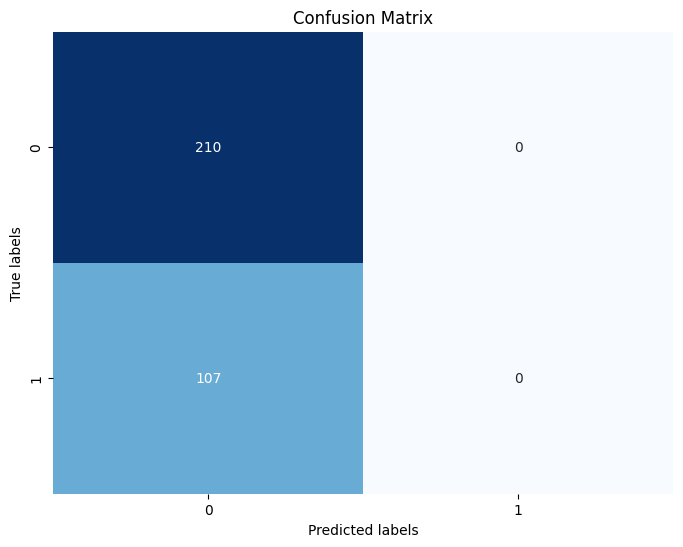

In [49]:
# Generate confusion matrix
cm = confusion_matrix(y_train, model_xgb.predict(X_train_selected))

# Plot confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()

In [50]:
from sklearn import metrics

def buildROC(target_test,test_preds):
    fpr, tpr, threshold = metrics.roc_curve(target_test, test_preds)
    roc_auc = metrics.auc(fpr, tpr)
    plt.title('ROC Curve')
    plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
    plt.legend(loc = 'lower right')
    plt.plot([0, 1], [0, 1],'r--')
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.gcf().savefig('roc.png')

In [51]:
test_preds = model_xgb.predict(X_val_selected)
target_test = y_val['viz_outcome_prolonged_los_yn']

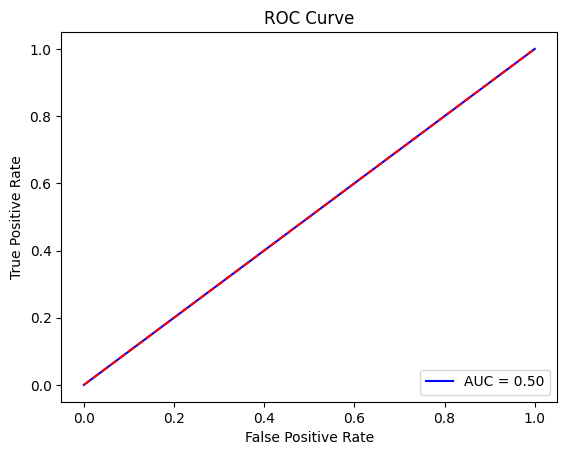

In [52]:
buildROC(target_test, test_preds)

In [53]:
def buildPR(target_test,test_preds):
    precision, recall, _ = metrics.precision_recall_curve(target_test, test_preds)
    pr_auc = metrics.auc(recall, precision)
    plt.title('PR Curve')
    plt.plot(recall, precision, label=f'PR-AUC = {pr_auc:.2f})')
    plt.legend(loc = 'lower right')
    plt.xlabel('Recall')
    plt.ylabel('Precision')

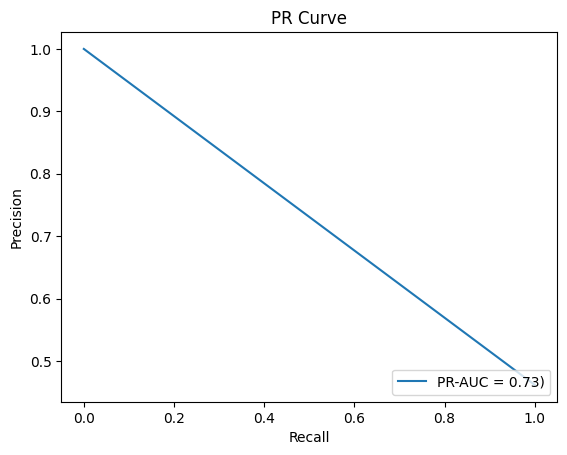

In [54]:
buildPR(target_test, test_preds)

In [55]:
def buildCC(target_test,test_preds):
      prob_true, prob_pred = calibration_curve(target_test, test_preds, n_bins=10)
      plt.plot(prob_pred, prob_true)
      plt.xlabel('Mean Predicted Probability')
      plt.ylabel('Fraction of Positives')

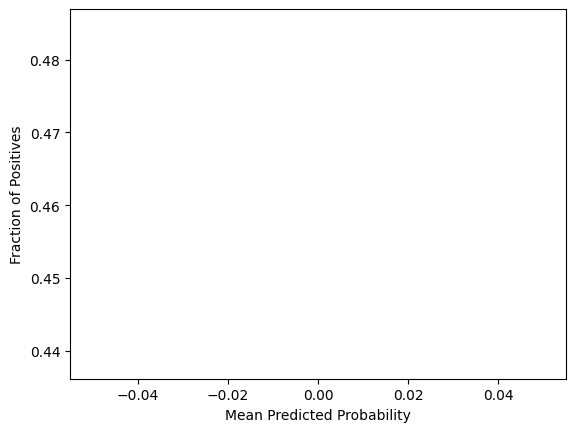

In [56]:
buildCC(target_test, test_preds)

In [57]:
#model_xgb.predict_proba(X_val)

In [58]:
model_xgb.best_estimator_.steps

[('encoder',
  TargetEncoder(cols=['thro_boarding_yn',
                      'con_max_consult_order_to_sign_is_signer_ym_provider_yn',
                      'con_max_consult_order_to_sign_is_signer_nemg_provider_yn',
                      'con_max_consult_order_to_sign_is_signer_community_provider_yn',
                      'con_max_consult_note_to_sign_is_signer_ym_provider_yn',
                      'con_max_consult_note_to_sign_is_signer_nemg_provider_yn',
                      'con_max_consult_note_to_sign_is_signer_community_provider_yn',
                      'icu_any_icu_yn'])),
 ('clf',
  XGBClassifier(base_score=None, booster=None, callbacks=None,
                colsample_bylevel=0.6301181140809947,
                colsample_bynode=0.7703817113387359,
                colsample_bytree=0.506103014140404, device=None,
                early_stopping_rounds=None, enable_categorical=False,
                eval_metric=None, feature_types=None, gamma=2.079165271399323,
              

<Axes: title={'center': 'Feature importance'}, xlabel='F score', ylabel='Features'>

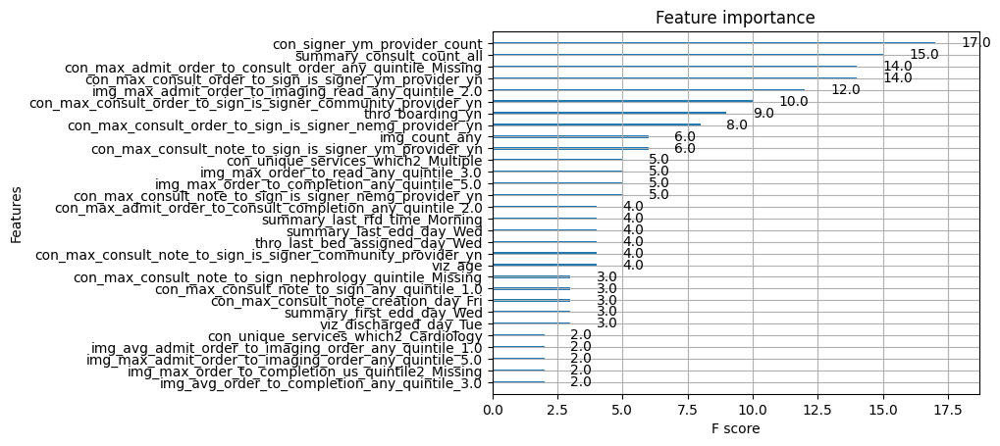

In [59]:
#https://www.youtube.com/watch?v=aLOQD66Sj0g&ab_channel=LianneandJustin
from xgboost import plot_importance

xgboost_step = model_xgb.best_estimator_.steps[1]
xgboost_model = xgboost_step[1]
plot_importance(xgboost_model, max_num_features=30)

In [60]:
xgboost_model

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=0.6301181140809947,
              colsample_bynode=0.7703817113387359,
              colsample_bytree=0.506103014140404, device=None,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, gamma=2.079165271399323,
              grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.0031574039841631043,
              max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=3, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, random_state=8, ...)

In [61]:
X_train_selected = pd.read_csv('/gpfs/milgram/project/rtaylor/imc33/data/pipeline/los_train_initial_selected_hf_patients_cat_only.csv', index_col=[0])

In [62]:
X_val_selected = pd.read_csv('/gpfs/milgram/project/rtaylor/imc33/data/pipeline/los_val_initial_selected_hf_patients_cat_only.csv', index_col=[0])

In [63]:
clf_xgb = xgb.XGBClassifier(objective='binary:logistic', missing=None, seed=42)
clf_xgb.fit(X_train_selected, 
            y_train['viz_outcome_prolonged_los_yn'], 
            verbose=True,
            early_stopping_rounds=10,
            eval_metric='aucpr',
            eval_set=[(X_val_selected, y_val['viz_outcome_prolonged_los_yn'])])

[0]	validation_0-aucpr:0.63332
[1]	validation_0-aucpr:0.55562
[2]	validation_0-aucpr:0.60762
[3]	validation_0-aucpr:0.63003
[4]	validation_0-aucpr:0.61424
[5]	validation_0-aucpr:0.57867
[6]	validation_0-aucpr:0.55157
[7]	validation_0-aucpr:0.55483
[8]	validation_0-aucpr:0.57077
[9]	validation_0-aucpr:0.58396


XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=None, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...)

In [64]:
explainer = shap.Explainer(clf_xgb)
shap_values = explainer(X_val_selected)

In [65]:
#1 shap value for each feature
np.shape(shap_values.values)

(78, 415)

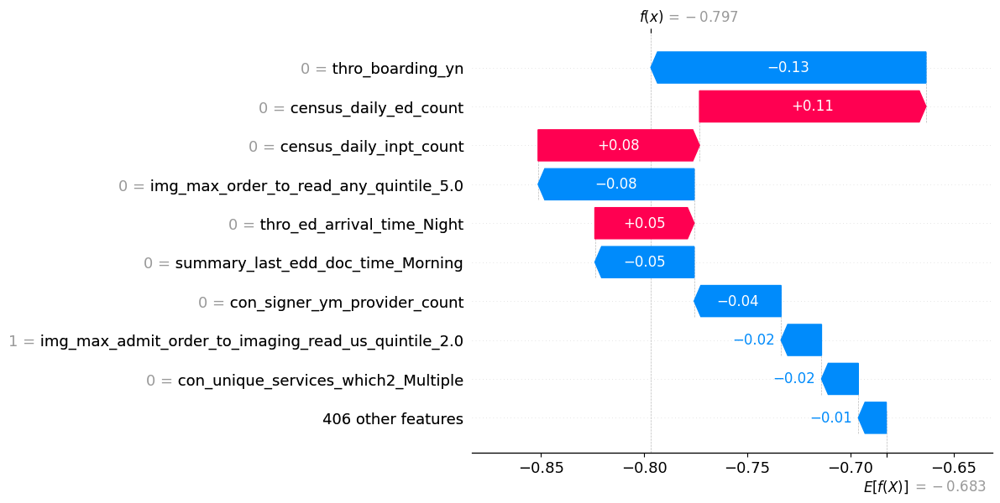

In [66]:
#This is for a single prediction
shap.plots.waterfall(shap_values[0])

In [67]:
shap.initjs(),
shap.plots.force(shap_values[0])

In [68]:
shap.plots.force(shap_values[0:100])

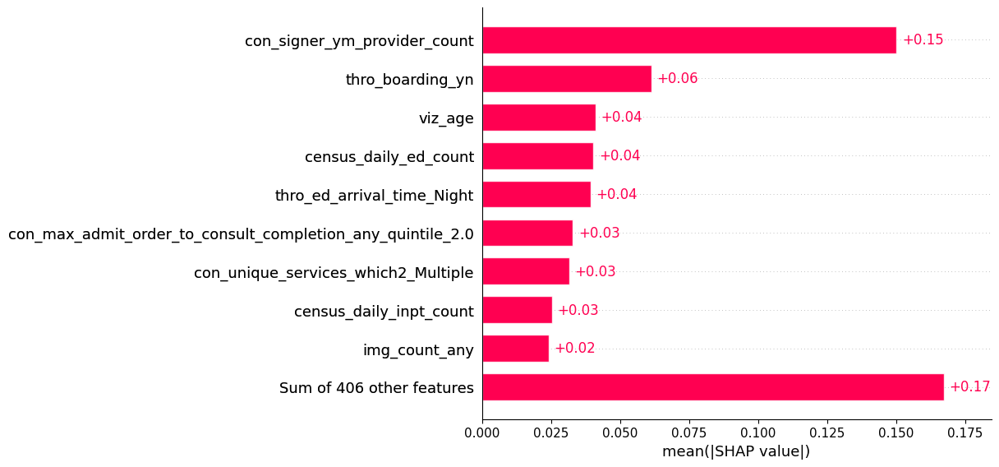

In [69]:
shap.plots.bar(shap_values)

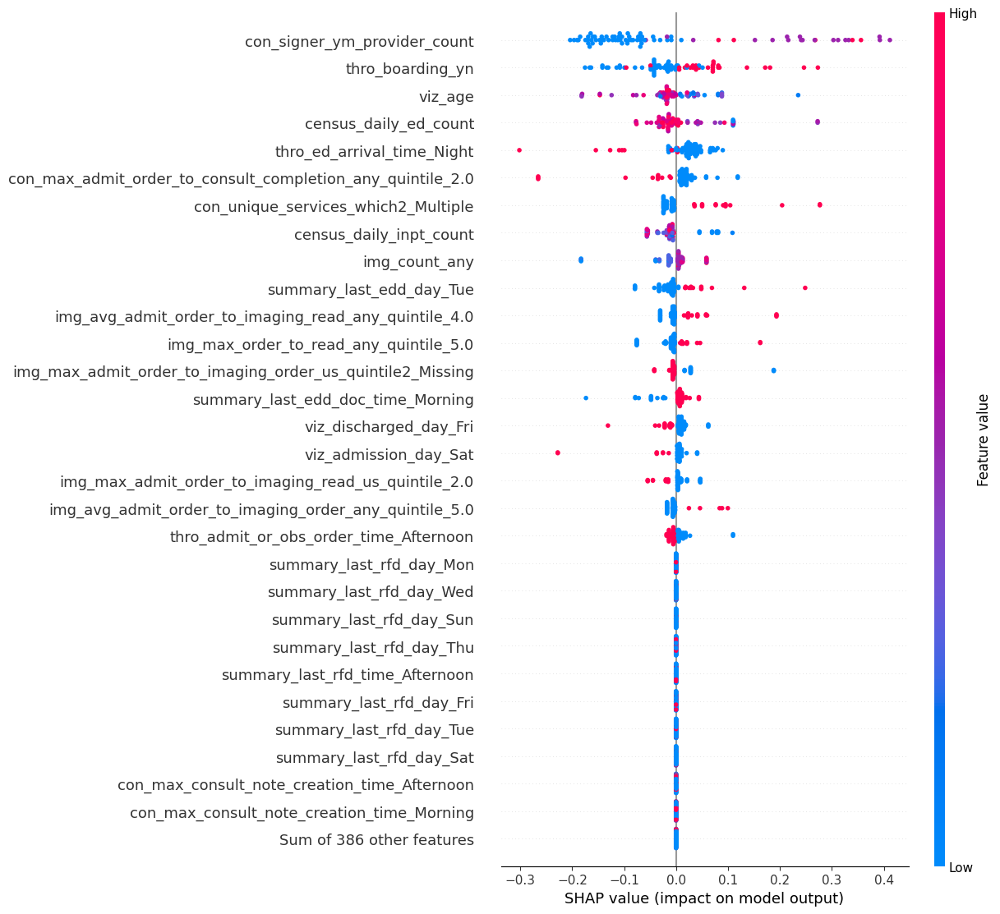

In [70]:
shap.plots.beeswarm(shap_values, max_display=30)

In [71]:
df_filt.shape

(395, 922)